## Map markers on the HCA Heart global manifold

- Carlos Talavera-López Ph.D
- WSI - 200720

### Import required modules

In [1]:
import anndata
import numpy as np
import pandas as pd
import scanpy as sc

/opt/conda/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


In [4]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 260, color_map = 'RdPu', dpi_save = 260, vector_friendly = True, format = 'svg')

scanpy==1.4.6 anndata==0.7.1 umap==0.3.10 numpy==1.19.0 scipy==1.5.1 pandas==0.24.0 scikit-learn==0.22.2 statsmodels==0.11.1 python-igraph==0.8.0 louvain==0.6.1


### Read in processed merged dataset

In [3]:
heart = sc.read_h5ad('/home/jovyan/experiments/hca_heart/1-scGEN_data_integration/hca_heart_global_ctl200609_freeze.h5ad')
heart.shape

(486134, 33538)

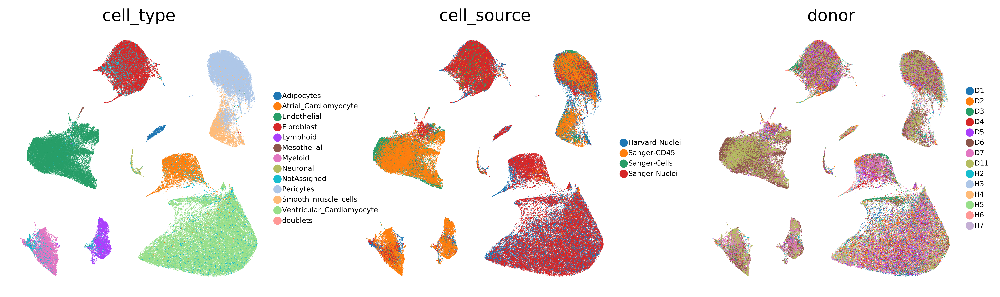

In [6]:
sc.pl.umap(heart, color = ['cell_type','cell_source','donor'], size = 0.4, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

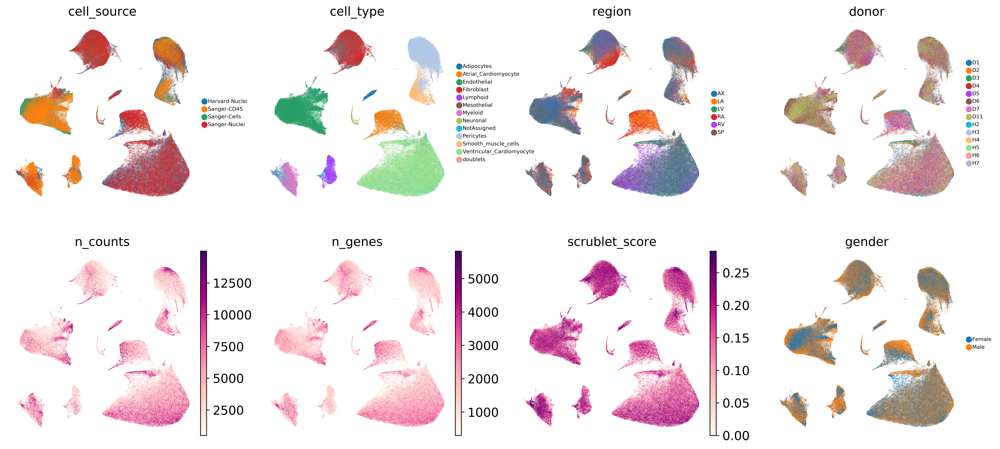

In [7]:
sc.pl.umap(heart, color = ['cell_source', 'cell_type', 'region', 'donor','n_counts', 'n_genes', 'scrublet_score', 'gender'], size = 0.4, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

- Normalise and log-transform data

In [9]:
heart_raw = heart.copy()
sc.pp.normalize_per_cell(heart)
sc.pp.log1p(heart)
heart.raw = heart.copy()

normalizing by total count per cell
    finished (0:01:55): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


### Plot cell-cycle genes

- Whitehead set

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_cell_type']`


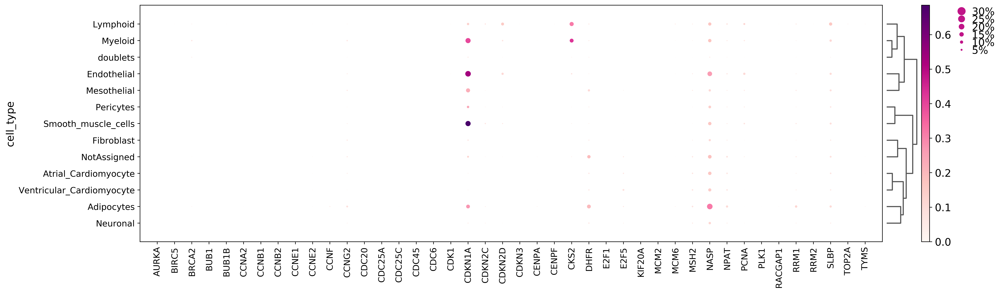

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[18.25, 0.8, 0.2, 0.5, 0.25])

In [10]:
whitehead_cell_cycle = ['AURKA','BIRC5','BRCA2','BUB1','BUB1B','CCNA2','CCNB1','CCNB2','CCNE1','CCNE2','CCNF','CCNG2','CDC20','CDC25A','CDC25C','CDC45','CDC6','CDK1','CDKN1A','CDKN2C','CDKN2D','CDKN3','CENPA','CENPF','CKS2','DHFR','E2F1','E2F5','KIF20A','MCM2','MCM6','MSH2','NASP','NPAT','PCNA','PLK1','RACGAP1','RRM1','RRM2','SLBP','TOP2A','TYMS']
sc.pl.dotplot(heart_raw, whitehead_cell_cycle, groupby = 'cell_type', dendrogram = True, color_map = 'RdPu', figsize = (20,6))

- KEEG set

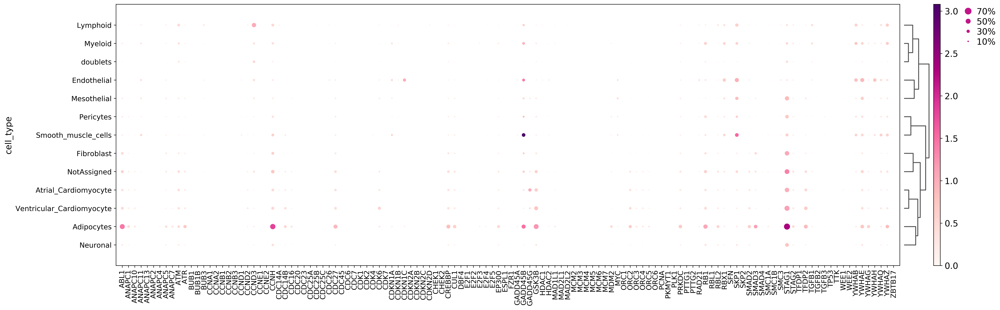

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[23.25, 0.8, 0.2, 0.5, 0.25])

In [11]:
kegg_cell_cycle = ['ABL1','ANAPC1','ANAPC10','ANAPC11','ANAPC13','ANAPC2','ANAPC4','ANAPC5','ANAPC7','ATM','ATR','BUB1','BUB1B','BUB3','CCNA1','CCNA2','CCNB1','CCNB2','CCNB3','CCND1','CCND2','CCND3','CCNE1','CCNE2','CCNH','CDC14A','CDC14B','CDC16','CDC20','CDC23','CDC25A','CDC25B','CDC25C','CDC26','CDC27','CDC45','CDC6','CDC7','CDK1','CDK2','CDK4','CDK6','CDK7','CDKN1A','CDKN1B','CDKN1C','CDKN2A','CDKN2B','CDKN2C','CDKN2D','CHEK1','CHEK2','CREBBP','CUL1','DBF4','E2F1','E2F2','E2F3','E2F4','E2F5','EP300','ESPL1','FZR1','GADD45A','GADD45B','GADD45G','GSK3B','HDAC1','HDAC2','MAD1L1','MAD2L1','MAD2L2','MCM2','MCM3','MCM4','MCM5','MCM6','MCM7','MDM2','MYC','ORC1','ORC2','ORC3','ORC4','ORC5','ORC6','PCNA','PKMYT1','PLK1','PRKDC','PTTG1','PTTG2','RAD21','RB1','RBL1','RBL2','RBX1','SFN','SKP1','SKP2','SMAD2','SMAD3','SMAD4','SMC1A','SMC1B','SMC3','STAG1','STAG2','TFDP1','TFDP2','TGFB1','TGFB2','TGFB3','TP53','TTK','WEE1','WEE2','YWHAB','YWHAE','YWHAG','YWHAH','YWHAQ','YWHAZ','ZBTB17']
sc.pl.dotplot(heart_raw, kegg_cell_cycle, groupby = 'cell_type', dendrogram = True, color_map = 'RdPu', figsize = (25,8))

### Plot GWAS genes from Harrison's 20th

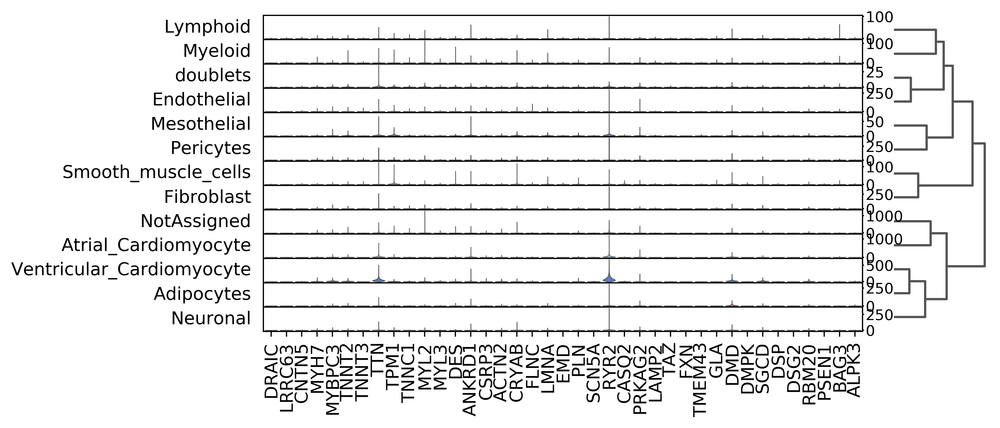

In [12]:
GWAS_AF = ['DRAIC', 'LRRC63', 'CNTN5', 'MYH7', 'MYBPC3', 'TNNT2', 'TNNT3', 'TTN', 'TPM1', 'TNNC1', 'MYL2', 'MYL3', 'DES', 'ANKRD1', 'CSRP3', 'ACTN2', 'CRYAB', 'FLNC', 'LMNA', 'EMD', 'PLN', 'SCN5A', 'RYR2', 'CASQ2', 'PRKAG2', 'LAMP2', 'TAZ', 'FXN', 'TMEM43', 'GLA', 'DMD', 'DMPK', 'SGCD', 'DSP', 'DSG2', 'RBM20', 'PSEN1', 'BAG3', 'ALPK3']
sc.pl.stacked_violin(heart_raw, GWAS_AF, groupby='cell_type', dendrogram = True, figsize = (8.5,3.8), jitter = True)

In [13]:
GWAS_AF = ['DRAIC', 'LRRC63', 'CNTN5', 'MYH7', 'MYBPC3', 'TNNT2', 'TNNT3', 'TTN', 'TPM1', 'TNNC1', 'MYL2', 'MYL3', 'DES', 'ANKRD1', 'CSRP3', 'ACTN2', 'CRYAB', 'FLNC', 'LMNA', 'EMD', 'PLN', 'SCN5A', 'RYR2', 'CASQ2', 'PRKAG2', 'LAMP2', 'TAZ', 'FXN', 'TMEM43', 'GLA', 'DMD', 'DMPK', 'SGCD', 'DSP', 'DSG2', 'RBM20', 'PSEN1', 'BAG3', 'ALPK3']
sc.pl.stacked_violin(heart_raw, GWAS_AF, groupby='leiden_annotated', dendrogram = True, figsize = (8.5,12))

ValueError: groupby has to be a valid observation. Given leiden_annotated, valid observations: ['NRP', 'age_group', 'cell_source', 'cell_type', 'donor', 'gender', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states', 'Used']